<a href="https://colab.research.google.com/github/HPG-AI/magenta_scripts/blob/master/Play_it_again%2C_AI_audio_to_midi_to_audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Play it again, AI

# GENERAL SETUP

In [ ]:
#@title Setup Environment (this will take a while)
%tensorflow_version 1.x
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function
from __future__ import unicode_literals

import glob

print('Copying checkpoint from GCS...')
!rm -r /content/onsets-frames
!mkdir /content/onsets-frames
!gsutil -q -m cp -R gs://magentadata/models/onsets_frames_transcription/* /content/onsets-frames/
!unzip -o /content/onsets-frames/maestro_checkpoint.zip -d /content/onsets-frames
CHECKPOINT_DIR = '/content/onsets-frames/train'
  
print('Installing dependencies...')
!apt-get update -qq && apt-get install -qq libfluidsynth1 fluid-soundfont-gm build-essential libasound2-dev libjack-dev ffmpeg  
!pip install pyfluidsynth pretty_midi youtube-dl Pafy
!pip install spleeter

import pafy

if glob.glob('/content/onsets-frames/magenta*.whl'):
  !pip install -q /content/onsets-frames/magenta*.whl
else:
  !pip install -qU magenta

# Hack to allow python to pick up the newly-installed fluidsynth lib. 
# This is only needed for the hosted Colab environment.
import ctypes.util
orig_ctypes_util_find_library = ctypes.util.find_library
def proxy_find_library(lib):
  if lib == 'fluidsynth':
    return 'libfluidsynth.so.1'
  else:
    return orig_ctypes_util_find_library(lib)
ctypes.util.find_library = proxy_find_library

Copying checkpoint from GCS...
rm: cannot remove '/content/onsets-frames': No such file or directory
Archive:  /content/onsets-frames/maestro_checkpoint.zip
   creating: /content/onsets-frames/train/
  inflating: /content/onsets-frames/train/model.ckpt.data-00000-of-00001  
  inflating: /content/onsets-frames/train/model.ckpt.meta  
  inflating: /content/onsets-frames/train/model.ckpt.index  
  inflating: /content/onsets-frames/train/checkpoint  
Installing dependencies...
Selecting previously unselected package fluid-soundfont-gm.
(Reading database ... 134443 files and directories currently installed.)
Preparing to unpack .../fluid-soundfont-gm_3.1-5.1_all.deb ...
Unpacking fluid-soundfont-gm (3.1-5.1) ...
Selecting previously unselected package libfluidsynth1:amd64.
Preparing to unpack .../libfluidsynth1_1.1.9-1_amd64.deb ...
Unpacking libfluidsynth1:amd64 (1.1.9-1) ...
Setting up fluid-soundfont-gm (3.1-5.1) ...
Setting up libfluidsynth1:amd64 (1.1.9-1) ...
Processing triggers for l

     |████████████████████████████████| 1.5MB 3.5MB/s 
     |████████████████████████████████| 110.5MB 54kB/s 
     |████████████████████████████████| 2.3MB 11.5MB/s 
     |████████████████████████████████| 204kB 45.1MB/s 
     |████████████████████████████████| 3.4MB 34.4MB/s 
     |████████████████████████████████| 512kB 49.6MB/s 
     |████████████████████████████████| 3.8MB 40.0MB/s 
     |████████████████████████████████| 61kB 6.5MB/s 
     |████████████████████████████████| 1.2MB 47.2MB/s 
     |████████████████████████████████| 59.2MB 75kB/s 
     |████████████████████████████████| 51kB 6.6MB/s 
     |████████████████████████████████| 122kB 54.5MB/s 
     |████████████████████████████████| 143kB 42.2MB/s 
     |████████████████████████████████| 174kB 56.5MB/s 
     |████████████████████████████████| 235kB 50.1MB/s 
     |████████████████████████████████| 92kB 11.4MB/s 
     |████████████████████████████████| 112kB 51.7MB/s 
ERROR: spleeter 1.4.9 has requirement tensorflow==1.14.

# Model initialization

In [ ]:
import tensorflow as tf
import librosa
import numpy as np

from google.colab import files

from magenta.common import tf_utils
from magenta.music import audio_io
import magenta.music as mm
from magenta.models.onsets_frames_transcription import audio_label_data_utils
from magenta.models.onsets_frames_transcription import configs
from magenta.models.onsets_frames_transcription import constants
from magenta.models.onsets_frames_transcription import data
from magenta.models.onsets_frames_transcription import infer_util
from magenta.models.onsets_frames_transcription import train_util
from magenta.music import midi_io
from magenta.music.protobuf import music_pb2
from magenta.music import sequences_lib

## Define model and load checkpoint
## Only needs to be run once.

config = configs.CONFIG_MAP['onsets_frames']
hparams = config.hparams
hparams.use_cudnn = False
hparams.batch_size = 1

examples = tf.placeholder(tf.string, [None])

dataset = data.provide_batch(
    examples=examples,
    preprocess_examples=True,
    params=hparams,
    is_training=False,
    shuffle_examples=False,
    skip_n_initial_records=0)

estimator = train_util.create_estimator(
    config.model_fn, CHECKPOINT_DIR, hparams)

iterator = dataset.make_initializable_iterator()
next_record = iterator.get_next()

SoX could not be found!

    If you do not have SoX, proceed here:
     - - - http://sox.sourceforge.net/ - - -

    If you do (or think that you should) have SoX, double-check your
    path variables.
    


The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
tf.py_func is deprecated in TF V2. Instead, there are two
    options available in V2.
    - tf.py_function takes a python function which manipulates tf eager
    tensors instead of numpy arrays. It's easy to convert a tf eager tensor to
    an ndarray (just call tensor.numpy()) but having access to eager tensors
    means `tf.py_function`s can use accelerators such as GPUs as well as
    being differentiable using a gradient tape.
    - tf.numpy_function maintains the semantics of the deprecated tf.py_func
    (it is not differentiable, and manipulates numpy arrays). It drops the
    stateful argument

# DOWNLOAD ORIGINAL AUDIO

In [ ]:
import pafy
from IPython.display import Audio

In [ ]:
!rm *.webm
!rm *.mp3
url = "https://www.youtube.com/watch?v=YTXhocAQqBI"
video = pafy.new(url)
bestaudio = video.getbestaudio()
bestaudio.download()
!mv *.webm sanremo.webm
!ffmpeg -i sanremo.webm -ss 3 -to 54  intro.webm
!ffmpeg -i intro.webm -vn -ar 44100 -ac 2 -ab 192k -f mp3 intro.mp3
Audio('intro.mp3')

rm: cannot remove '*.webm': No such file or directory
rm: cannot remove '*.mp3': No such file or directory


NameError: ignored

# STEM SEPARATION WITH SPLEETER

In [ ]:
!spleeter separate -i intro.mp3 -o output/

INFO:spleeter:Downloading model archive https://github.com/deezer/spleeter/releases/download/v1.4.0/2stems.tar.gz
INFO:spleeter:Validating archive checksum
INFO:spleeter:Extracting downloaded 2stems archive
INFO:spleeter:2stems model file(s) extracted
INFO:spleeter:File output/intro/vocals.wav written
INFO:spleeter:File output/intro/accompaniment.wav written


In [ ]:
pianoAudio = './output/intro/accompaniment.wav'
Audio(pianoAudio)

# AUDIO TO MIDI WITH MAGENTA
![alt text](https://tech.uqido.com/wp-content/uploads/2020/02/xwestworld.jpg.pagespeed.ic.q4R669hNoL.webp)

In [ ]:
to_process = []
with open(pianoAudio, mode='rb') as file: 
    wav_data = file.read()
example_list = list(
      audio_label_data_utils.process_record(
          wav_data=wav_data,
          ns=music_pb2.NoteSequence(),
          example_id='accompaniment.wav',
          min_length=0,
          max_length=-1,
          allow_empty_notesequence=True))
to_process.append(example_list[0].SerializeToString())

In [ ]:
sess = tf.Session()

sess.run([
    tf.initializers.global_variables(),
    tf.initializers.local_variables()
])

sess.run(iterator.initializer, {examples: to_process})

def transcription_data(params):
  del params
  return tf.data.Dataset.from_tensors(sess.run(next_record))
input_fn = infer_util.labels_to_features_wrapper(transcription_data)



In [ ]:
prediction_list = list(
    estimator.predict(
        input_fn,
        yield_single_examples=False))
assert len(prediction_list) == 1

frame_predictions = prediction_list[0]['frame_predictions'][0]
onset_predictions = prediction_list[0]['onset_predictions'][0]
velocity_values = prediction_list[0]['velocity_values'][0]

sequence_prediction = sequences_lib.pianoroll_to_note_sequence(
    frame_predictions,
    frames_per_second=data.hparams_frames_per_second(hparams),
    min_duration_ms=0,
    min_midi_pitch=constants.MIN_MIDI_PITCH,
    onset_predictions=onset_predictions,
    velocity_values=velocity_values)

# Ignore warnings caused by pyfluidsynth
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
#https://github.com/tensorflow/magenta/blob/master/magenta/music/notebook_utils.py
import bokeh
import bokeh.plotting

fig = mm.plot_sequence(sequence_prediction, show_figure=False)
fig.plot_width = 1000
fig.plot_height = 400
bokeh.plotting.output_notebook()
bokeh.plotting.show(fig)


Instructions for updating:
If using Keras pass *_constraint arguments to layers.

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Running infer on CPU

Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Please use `keras.layers.Bidirectional(keras.layers.RNN(cell))`, which is equivalent to this API
Instructions for updating:
Please use `keras.layers.RNN(cell)`, which is equivalent to this API
Instructions for updating:
Please use `layer.add_weight` method instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
Use `tf.cast` instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.

INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /content/onsets-frames/train/model.ckpt
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.

INFO:tensorflow:C

In [ ]:
fig = mm.plot_sequence(sequence_prediction, show_figure=False)
fig.plot_width = 1000
fig.plot_height = 400
bokeh.plotting.output_notebook()
bokeh.plotting.show(fig)

In python notebooks we can use this magenta shorthand for embeddding a rendered notesequence

In [ ]:
mm.play_sequence(sequence_prediction, mm.midi_synth.fluidsynth,
                 colab_ephemeral=False)

To save the audio to file I use this:


In [ ]:
from scipy.io import wavfile
array_of_floats = mm.midi_synth.fluidsynth(sequence_prediction,44100)
normalizer = float(np.iinfo(np.int16).max)
array_of_ints = np.array(
      np.asarray(array_of_floats) * normalizer, dtype=np.int16)
wavfile.write('rendered_piano.wav', 44100, array_of_ints)

In [ ]:
Audio('rendered_piano.wav')

# REMIXING IT BACK
![alt text](https://tech.uqido.com/wp-content/uploads/2020/02/xcylon_and_garf.jpg.pagespeed.ic.HuA9_w1ujE.webp)

In [ ]:
!pip install pydub

In [ ]:
from pydub import AudioSegment
sound1 = AudioSegment.from_file("rendered_piano.wav", format="wav")
sound2 = AudioSegment.from_file("output/intro/vocals.wav", format="wav")
played_togther = sound1.overlay(sound2, gain_during_overlay=-15)
played_togther.export("robot_piano_and_human_voice.mp3", format="mp3")

<_io.BufferedRandom name='robot_piano_and_human_voice.mp3'>

In [ ]:
Audio("robot_piano_and_human_voice.mp3")

# EXPORTING MIDI FILE

In [ ]:
midi_filename = ('intro.mid')
midi_io.sequence_proto_to_midi_file(sequence_prediction, midi_filename)

#files.download(midi_filename)

In [ ]:
files.download('intro.mid')

# RESYNTHESIS
Adapted from https://colab.research.google.com/notebooks/magenta/gansynth/gansynth_demo.ipynb#scrollTo=DCA9o-PI5VV_

In [ ]:
print('Copying checkpoint from GCS...')
!rm -r /content/gansynth &>/dev/null
!mkdir /content/gansynth
!mkdir /content/gansynth/midi
!mkdir /content/gansynth/samples
!gsutil -q -m cp gs://magentadata/models/gansynth/acoustic_only.zip /content/gansynth/
!unzip -o /content/gansynth/acoustic_only.zip -d /content/gansynth &>/dev/null


Copying checkpoint from GCS...


In [ ]:
import os
from google.colab import files
import librosa
from magenta import music as mm
from magenta.music.notebook_utils import colab_play as play
from magenta.models.nsynth.utils import load_audio
from magenta.models.gansynth.lib import flags as lib_flags
from magenta.models.gansynth.lib import generate_util as gu
from magenta.models.gansynth.lib import model as lib_model
from magenta.models.gansynth.lib import util
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

# File IO
download = files.download

In [ ]:
# GLOBALS
CKPT_DIR = '/content/gansynth/acoustic_only'
output_dir = '/content/gansynth/samples'
BATCH_SIZE = 16
SR = 16000

# Make an output directory if it doesn't exist
OUTPUT_DIR = util.expand_path(output_dir)
if not tf.gfile.Exists(OUTPUT_DIR):
  tf.gfile.MakeDirs(OUTPUT_DIR)

# Load the model
tf.reset_default_graph()
flags = lib_flags.Flags({'batch_size_schedule': [BATCH_SIZE]})
model = lib_model.Model.load_from_path(CKPT_DIR, flags)

def load_midi(midi_path, min_pitch=36, max_pitch=84):
  """Load midi as a notesequence."""
  midi_path = util.expand_path(midi_path)
  ns = mm.midi_file_to_sequence_proto(midi_path)
  pitches = np.array([n.pitch for n in ns.notes])
  velocities = np.array([n.velocity for n in ns.notes])
  start_times = np.array([n.start_time for n in ns.notes])
  end_times = np.array([n.end_time for n in ns.notes])
  valid = np.logical_and(pitches >= min_pitch, pitches <= max_pitch)
  notes = {'pitches': pitches[valid],
           'velocities': velocities[valid],
           'start_times': start_times[valid],
           'end_times': end_times[valid]}
  return ns, notes

def get_envelope(t_note_length, t_attack=0.010, t_release=0.3, sr=16000):
  """Create an attack sustain release amplitude envelope."""
  t_note_length = min(t_note_length, 3.0)
  i_attack = int(sr * t_attack)
  i_sustain = int(sr * t_note_length)
  i_release = int(sr * t_release)
  i_tot = i_sustain + i_release  # attack envelope doesn't add to sound length
  envelope = np.ones(i_tot)
  # Linear attack
  envelope[:i_attack] = np.linspace(0.0, 1.0, i_attack)
  # Linear release
  envelope[i_sustain:i_tot] = np.linspace(1.0, 0.0, i_release)
  return envelope

def combine_notes(audio_notes, start_times, end_times, velocities, sr=16000):
  """Combine audio from multiple notes into a single audio clip.

  Args:
    audio_notes: Array of audio [n_notes, audio_samples].
    start_times: Array of note starts in seconds [n_notes].
    end_times: Array of note ends in seconds [n_notes].
    sr: Integer, sample rate.

  Returns:
    audio_clip: Array of combined audio clip [audio_samples]
  """
  n_notes = len(audio_notes)
  clip_length = end_times.max() + 3.0
  audio_clip = np.zeros(int(clip_length) * sr)

  for t_start, t_end, vel, i in zip(start_times, end_times, velocities, range(n_notes)):
    # Generate an amplitude envelope
    t_note_length = t_end - t_start
    envelope = get_envelope(t_note_length)
    length = len(envelope)
    audio_note = audio_notes[i, :length] * envelope
    # Normalize
    audio_note /= audio_note.max()
    audio_note *= (vel / 127.0)
    # Add to clip buffer
    clip_start = int(t_start * sr)
    clip_end = clip_start + length
    audio_clip[clip_start:clip_end] += audio_note

  # Normalize
  audio_clip /= audio_clip.max()
  audio_clip /= 2.0
  return audio_clip

# Plotting tools
def specplot(audio_clip):
  p_min = np.min(36)
  p_max = np.max(84)
  f_min = librosa.midi_to_hz(p_min)
  f_max = 2 * librosa.midi_to_hz(p_max)
  octaves = int(np.ceil(np.log2(f_max) - np.log2(f_min)))
  bins_per_octave = 36
  n_bins = int(bins_per_octave * octaves)
  C = librosa.cqt(audio_clip, sr=SR, hop_length=2048, fmin=f_min, n_bins=n_bins, bins_per_octave=bins_per_octave)
  power = 10 * np.log10(np.abs(C)**2 + 1e-6)
  plt.matshow(power[::-1, 2:-2], aspect='auto', cmap=plt.cm.magma)
  plt.yticks([])
  plt.xticks([])

print('And...... Done!')


	adam_beta1: 0.0
	adam_beta2: 0.99
	audio_length: 64000
	batch_size_schedule: [8]
	d_fn: specgram
	data_normalizer: specgrams_prespecified_normalizer
	data_type: mel
	dataset_name: nsynth_tfrecord
	debug_hook: False
	discriminator_ac_loss_weight: 10.0
	discriminator_learning_rate: 0.0008
	fake_batch_size: 61
	fmap_base: 4096
	fmap_decay: 1.0
	fmap_max: 256
	g_fn: specgram
	gan:
	gen_gl_consistency_loss_weight: 0.0
	generator_ac_loss_weight: 10.0
	generator_learning_rate: 0.0008
	gradient_penalty_target: 1.0
	gradient_penalty_weight: 10.0
	kernel_size: 3
	latent_vector_size: 256
	mag_normalizer_a: 0.0661371661726
	mag_normalizer_b: 0.113718730221
	master: 
	normalizer_margin: 0.8
	normalizer_num_examples: 1000
	num_resolutions: 7
	p_normalizer_a: 0.8
	p_normalizer_b: 0.0
	ps_tasks: 0
	real_score_penalty_weight: 0.001
	sample_rate: 16000
	save_summaries_num_images: 10000
	scale_base: 2
	scale_mode: ALL
	simple_arch: False
	stable_stage_num_images: 800000
	start_height: 2
	start_width: 1

In [ ]:
number_of_random_instruments = 10 #@param {type:"slider", min:4, max:16, step:1}
pitch_preview = 60
n_preview = number_of_random_instruments

pitches_preview = [pitch_preview] * n_preview
z_preview = model.generate_z(n_preview)

audio_notes = model.generate_samples_from_z(z_preview, pitches_preview)
for i, audio_note in enumerate(audio_notes):
  print("Instrument: {}".format(i))
  play(audio_note, sample_rate=16000)


generate_samples: generated 10 samples in 13.641838312149048s
Instrument: 0


Instrument: 1


Instrument: 2


Instrument: 3


Instrument: 4


Instrument: 5


Instrument: 6


Instrument: 7


Instrument: 8


Instrument: 9


In [ ]:
 ns, notes_2 = load_midi('intro.mid')

Generating 153 samples...
generate_samples: generated 153 samples in 118.8000738620758s
Saved to /content/gansynth/samples/generated_clip.wav

Audio:


CQT Spectrogram:
Mix:


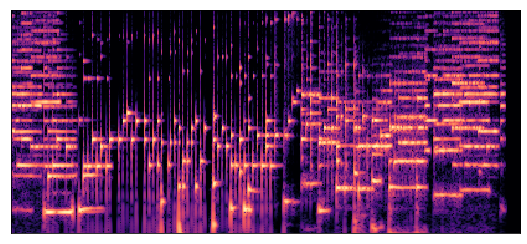

In [ ]:
#@title Generate custom interpolation 🎵
##@markdown Using the instrument numbers from the cell above, pick two instruments to interpolate between over the clip.

#@markdown Using the instrument numbers from the cell above, create a list of instruments to interpolate between. You can repeat instruments.

instruments = [0, 2, 4, 0] #@param

#@markdown For each instrument in the list above, place it at a relative time [0-1.0] in the clip. __The list of times must _always increase_ and start at 0 and end at 1.0__.

times = [0, 0.3, 0.6, 1.0] #@param

# Force endpoints
times[0] = -0.001
times[-1] = 1.0

#@markdown This cell plays and displays a [Constant-Q spectrogram](https://en.wikipedia.org/wiki/Constant-Q_transform) of the synthesized audio.

z_instruments = [z_preview[i] for i in instruments]
t_instruments = [notes_2['end_times'][-1] * t for t in times]

# Get latent vectors for each note
z_notes = gu.get_z_notes(notes_2['start_times'], z_instruments, t_instruments)

# Generate audio for each note
print('Generating {} samples...'.format(len(z_notes)))
audio_notes = model.generate_samples_from_z(z_notes, notes_2['pitches'])

# Make a single audio clip
audio_clip = combine_notes(audio_notes,
                           notes_2['start_times'],
                           notes_2['end_times'],
                           notes_2['velocities'])

fname = os.path.join(output_dir, 'generated_clip.wav')
mix_fname = os.path.join(output_dir, 'generated_mix.wav')
gu.save_wav(audio_clip, fname)

from pydub import AudioSegment
sound1 = AudioSegment.from_file(fname, format="wav")
sound2 = AudioSegment.from_file("output/intro/vocals.wav", format="wav")
played_togther = sound1.overlay(sound2, gain_during_overlay=-15)
played_togther.export(mix_fname, format="mp3")

# Play the audio
print('\nAudio:')
play(audio_clip, sample_rate=SR)
print('CQT Spectrogram:')
specplot(audio_clip)
print('Mix:')
Audio(mix_fname)